In [169]:
""" Imports """

from collections import namedtuple
import time
import os
import sys
import copy
import gc

import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.autograd import Variable

from PIL import Image

import torchvision.transforms as transforms
import torchvision.models as models
from torch.utils.data import DataLoader
from torchvision import datasets

from utils import *
from style_subnet import *
from enhance_subnet import *
from refine_subnet import *

# for auto-reloading external modules
# see http://stackoverflow.com/questions/1907993/autoreload-of-modules-in-ipython
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [170]:
IMAGE_SIZE = 256
BATCH_SIZE = 4
STYLE_NAME = "forest1024"
LR = 1e-3
NUM_EPOCHS = 2
CONTENT_WEIGHTS = [1, 1, 1]
STYLE_WEIGHTS = [2e4, 1e5, 1e3] # Checkpoint single style
#STYLE_WEIGHTS = [5e4, 8e4, 3e4] # Checkpoint two styles
LAMBDAS = [1., 0.5, 0.25]
REG = 1e-7
LOG_INTERVAL = 25

In [171]:
""" Allow PIL to read truncated blocks when loading images """

from PIL import ImageFile
ImageFile.LOAD_TRUNCATED_IMAGES = True

In [172]:
""" Add a seed to have reproducable results """

SEED = 1080
torch.manual_seed(SEED)

In [173]:
""" Configure training with or without cuda """

if torch.cuda.is_available():
    device = torch.device("cuda")
    torch.cuda.manual_seed(SEED)
    torch.set_default_tensor_type('torch.cuda.FloatTensor')
    kwargs = {'num_workers': 4, 'pin_memory': True}
else:
    device = torch.device("cpu")
    torch.set_default_tensor_type('torch.FloatTensor')
    kwargs = {}

In [174]:
""" Load coco dataset """

print("Loading dataset..")
scriptDir = os.path.dirname(os.path.realpath('__file__'))
DATASET = scriptDir + "/coco/"
transform = transforms.Compose([transforms.Resize(IMAGE_SIZE),
                                transforms.CenterCrop(IMAGE_SIZE),
                                transforms.ToTensor(), tensor_normalizer()])
# http://pytorch.org/docs/master/torchvision/datasets.html#imagefolder
train_dataset = datasets.ImageFolder(DATASET, transform)
# http://pytorch.org/docs/master/data.html#torch.utils.data.DataLoader
train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=False, **kwargs)

Loading dataset..


In [175]:
""" Load Style Image """

style_img_256, style_img_512, style_img_1024 = style_loader(
    "styles/" + STYLE_NAME + ".jpg", device, [256, 512, 1024])

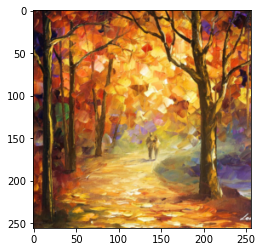

In [176]:
imshow(style_img_256)

In [177]:
""" Define Loss Network """
########## ["relu1_1", "relu2_2", "relu3_3", "relu4_3"] ##########
StyleOutput = namedtuple("StyleOutput", ["relu1_1", "relu2_2", "relu3_3", "relu4_3"])

########## ["relu2_2"] ##########
ContentOutput = namedtuple("ContentOutput", ["relu2_2"])

# https://discuss.pytorch.org/t/how-to-extract-features-of-an-image-from-a-trained-model/119/3
class LossNetwork(torch.nn.Module):
    def __init__(self, vgg):
        super(LossNetwork, self).__init__()
        self.vgg = vgg
        self.layer_name_mapping = {
            '1': "relu1_1", '3': "relu1_2",
            '6': "relu2_1", '8': "relu2_2",
            '11': "relu3_1", '13': "relu3_2", '15': "relu3_3", '17': "relu3_4",
            '20': "relu4_1", '22': "relu4_2", '24': "relu4_3", '26': "relu4_4",
            '29': "relu5_1", '31': "relu5_2", '33': "relu5_3", '35': "relu5_4"
        }

    def forward(self, x, mode):
        if mode == 'style':
            ########## ["relu1_1", "relu2_2", "relu3_3", "relu4_3"] ##########
            ########## ['1', '8', '15', '24'] ##########
            layers = ['1', '8', '15', '24']
        elif mode == 'content':
            ########## ["relu2_2"] ##########
            ########## ['8'] ##########
            layers = ['8']
        else:
            print("Invalid mode. Select between 'style' and 'content'")
        output = {}
        for name, module in self.vgg._modules.items():
            x = module(x)
            if name in layers:
                output[self.layer_name_mapping[name]] = x
        if mode == 'style':
            return StyleOutput(**output)
        else:
            return ContentOutput(**output)

In [178]:
""" Load and extract features from VGG16 """

print("Loading VGG..")
vgg = models.vgg19(pretrained=True).features.to(device).eval()
loss_network = LossNetwork(vgg).to(device).eval()
del vgg

Loading VGG..


In [179]:
""" Before training, compute the features of every resolution of the style image """

print("Computing style features..")
with torch.no_grad(): 
    style_loss_features_256 = loss_network(Variable(style_img_256), 'style')

gram_style_256 = [Variable(gram_matrix(y).data, requires_grad=False) for y in style_loss_features_256]

Computing style features..


In [180]:
""" Init Net and loss """

style_subnet = StyleSubnet().to(device)

In [181]:
""" Prepare Training """

max_iterations = min(500, len(train_dataset))

# init loss
mse_loss = torch.nn.MSELoss()
# init optimizer
optimizer = torch.optim.Adam(list(style_subnet.parameters()), lr=LR)

def getLosses(generated_img, resized_input_img, content_weight, style_weight, mse_loss, gram_style):
    
    # Compute features
    generated_style_features = loss_network(generated_img, 'style')
    generated_content_features = loss_network(generated_img, 'content')
    target_content_features = loss_network(resized_input_img, 'content')
    
    # Content loss
    target_content_features = Variable(target_content_features[0].data, requires_grad=False)
    content_loss = content_weight * mse_loss(generated_content_features[0], target_content_features)
    
    # Style loss
    style_loss = 0.
    for m in range(len(generated_style_features)):
        gram_s = gram_style[m]
        gram_y = gram_matrix(generated_style_features[m])
        style_loss += style_weight * mse_loss(gram_y, gram_s.expand_as(gram_y))
    
    # Regularization loss
    reg_loss = REG * (
        torch.sum(torch.abs(generated_img[:, :, :, :-1] - generated_img[:, :, :, 1:])) + 
        torch.sum(torch.abs(generated_img[:, :, :-1, :] - generated_img[:, :, 1:, :])))
    
    return content_loss, style_loss, reg_loss

Start training on cpu...
Fri Jan  8 01:09:27 2021 [25/500] time per pass: 14.86s  total time: 371.40s  estimated time left: 1.96h  content: 6.226453  style: 6.117256  reg: 0.015025  total: 12.358734


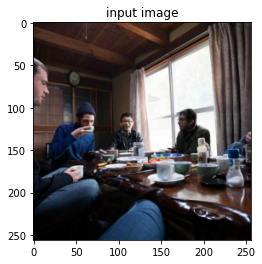

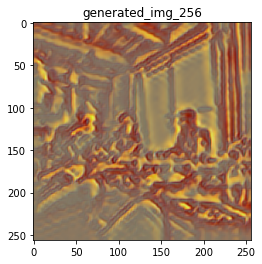

Fri Jan  8 01:15:23 2021 [50/500] time per pass: 14.54s  total time: 726.89s  estimated time left: 1.82h  content: 6.368149  style: 2.678330  reg: 0.019523  total: 9.066003


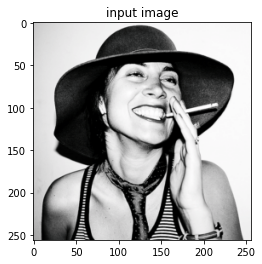

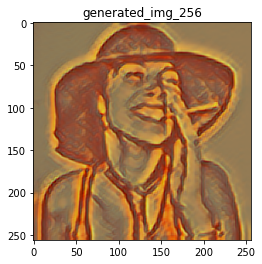

Fri Jan  8 01:21:15 2021 [75/500] time per pass: 14.39s  total time: 1078.89s  estimated time left: 1.70h  content: 5.601567  style: 2.130987  reg: 0.020361  total: 7.752915


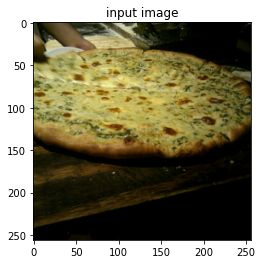

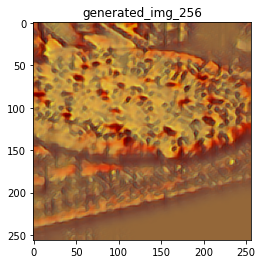

Fri Jan  8 01:26:59 2021 [100/500] time per pass: 14.23s  total time: 1423.05s  estimated time left: 1.59h  content: 5.407131  style: 1.900904  reg: 0.020865  total: 7.328900


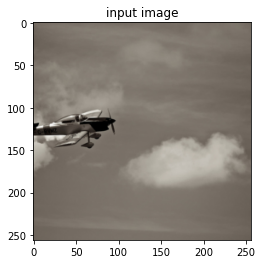

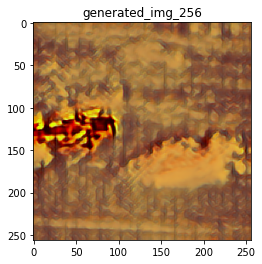

Fri Jan  8 01:32:45 2021 [125/500] time per pass: 14.15s  total time: 1769.06s  estimated time left: 1.48h  content: 5.253485  style: 1.806988  reg: 0.021383  total: 7.081857


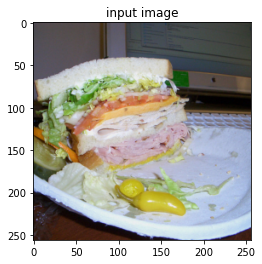

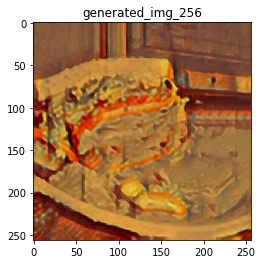

Fri Jan  8 01:38:19 2021 [150/500] time per pass: 14.02s  total time: 2103.23s  estimated time left: 1.37h  content: 5.090166  style: 1.815588  reg: 0.021639  total: 6.927394


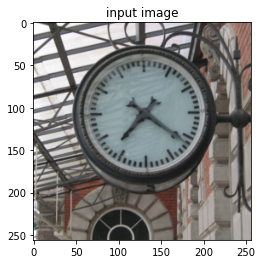

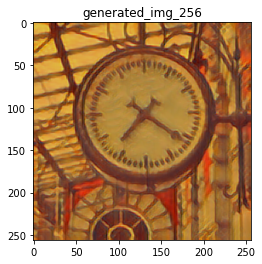

Fri Jan  8 01:43:49 2021 [175/500] time per pass: 13.90s  total time: 2433.34s  estimated time left: 1.26h  content: 4.893011  style: 1.674927  reg: 0.022090  total: 6.590029


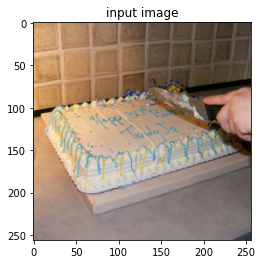

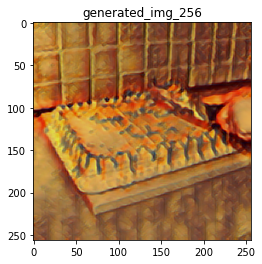

Fri Jan  8 01:49:16 2021 [200/500] time per pass: 13.80s  total time: 2759.91s  estimated time left: 1.15h  content: 4.779062  style: 1.628323  reg: 0.022465  total: 6.429849


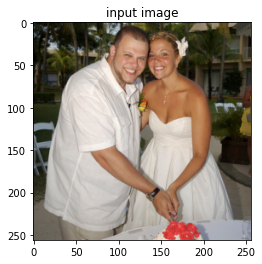

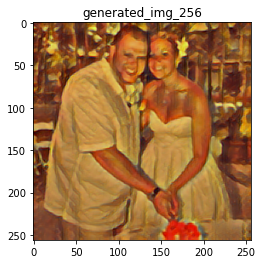

Fri Jan  8 01:54:43 2021 [225/500] time per pass: 13.72s  total time: 3086.83s  estimated time left: 1.05h  content: 4.470641  style: 1.647971  reg: 0.022357  total: 6.140969


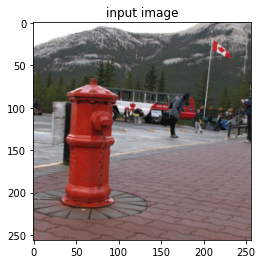

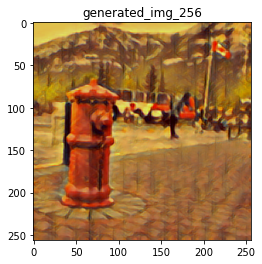

Fri Jan  8 02:00:10 2021 [250/500] time per pass: 13.66s  total time: 3413.91s  estimated time left: 0.95h  content: 4.375196  style: 1.631323  reg: 0.022701  total: 6.029221


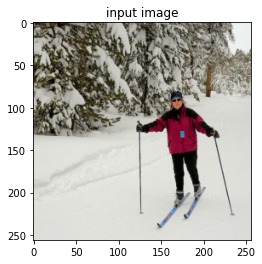

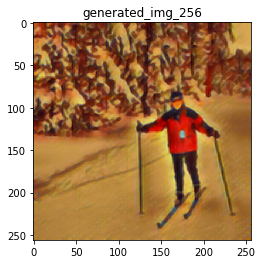

Fri Jan  8 02:05:37 2021 [275/500] time per pass: 13.60s  total time: 3741.00s  estimated time left: 0.85h  content: 4.407425  style: 1.635681  reg: 0.023007  total: 6.066113


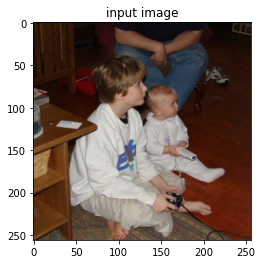

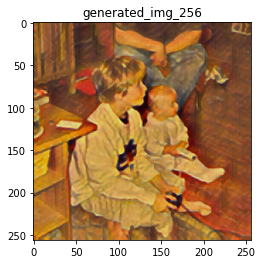

Fri Jan  8 02:11:07 2021 [300/500] time per pass: 13.57s  total time: 4071.58s  estimated time left: 0.76h  content: 4.384475  style: 1.610849  reg: 0.022724  total: 6.018047


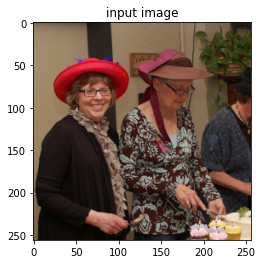

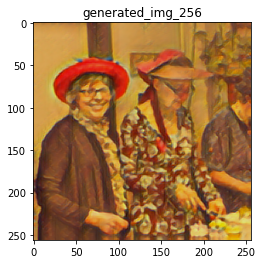

Fri Jan  8 02:16:35 2021 [325/500] time per pass: 13.54s  total time: 4399.36s  estimated time left: 0.66h  content: 4.299496  style: 1.502547  reg: 0.023445  total: 5.825487


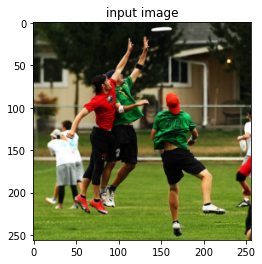

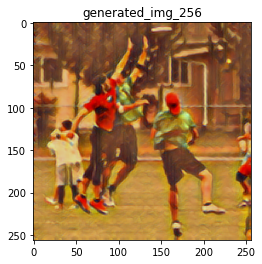

Fri Jan  8 02:22:02 2021 [350/500] time per pass: 13.50s  total time: 4726.29s  estimated time left: 0.57h  content: 4.106554  style: 1.624061  reg: 0.022760  total: 5.753376


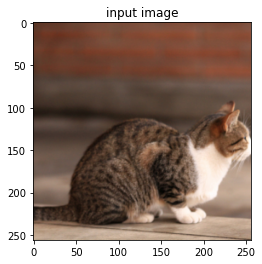

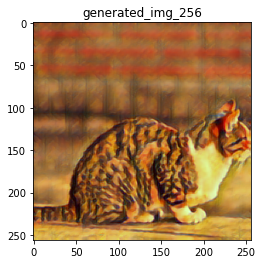

Fri Jan  8 02:27:31 2021 [375/500] time per pass: 13.48s  total time: 5055.34s  estimated time left: 0.47h  content: 3.968315  style: 1.563980  reg: 0.022882  total: 5.555177


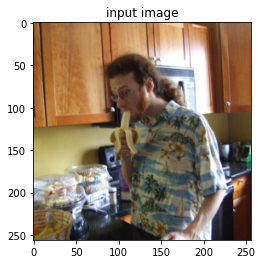

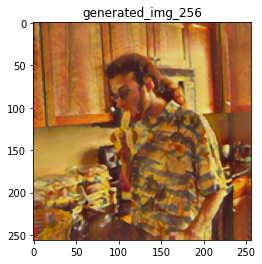

Fri Jan  8 02:32:58 2021 [400/500] time per pass: 13.45s  total time: 5381.81s  estimated time left: 0.38h  content: 3.954981  style: 1.470948  reg: 0.023483  total: 5.449412


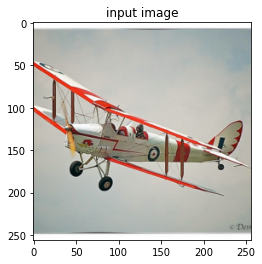

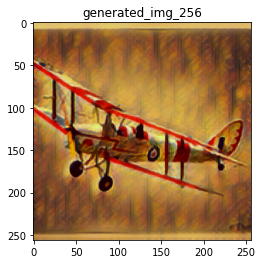

Fri Jan  8 02:38:26 2021 [425/500] time per pass: 13.44s  total time: 5710.17s  estimated time left: 0.28h  content: 3.929949  style: 1.486238  reg: 0.023073  total: 5.439260


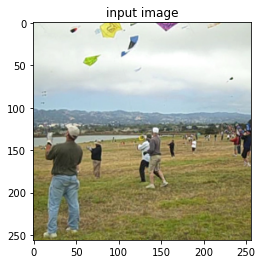

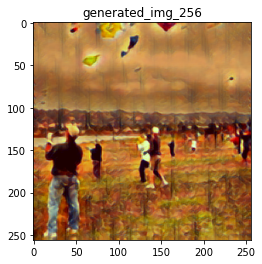

Fri Jan  8 02:43:53 2021 [450/500] time per pass: 13.42s  total time: 6037.02s  estimated time left: 0.19h  content: 3.942312  style: 1.526300  reg: 0.023000  total: 5.491611


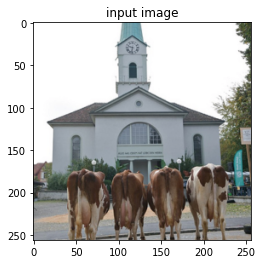

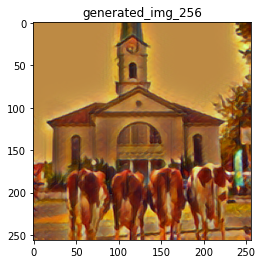

Fri Jan  8 02:49:20 2021 [475/500] time per pass: 13.40s  total time: 6364.13s  estimated time left: 0.10h  content: 3.805096  style: 1.524596  reg: 0.023015  total: 5.352708


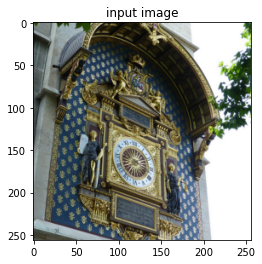

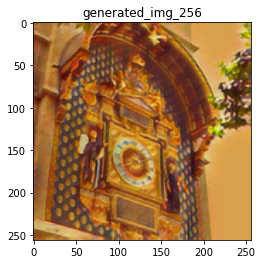

Fri Jan  8 02:54:48 2021 [500/500] time per pass: 13.38s  total time: 6691.68s  estimated time left: 0.00h  content: 3.801309  style: 1.489461  reg: 0.023316  total: 5.314086


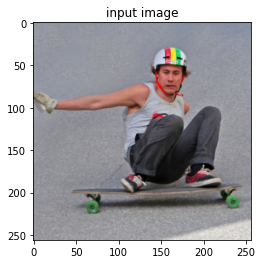

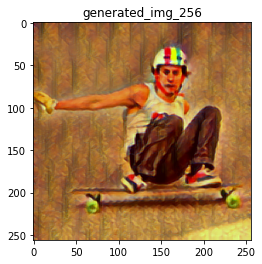

Fri Jan  8 03:00:13 2021 [25/500] time per pass: 280.68s  total time: 7017.03s  estimated time left: 37.11h  content: 3.716150  style: 1.470598  reg: 0.022916  total: 5.209664


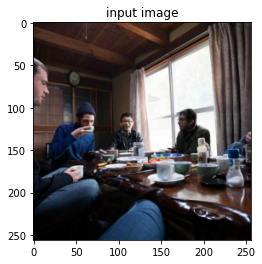

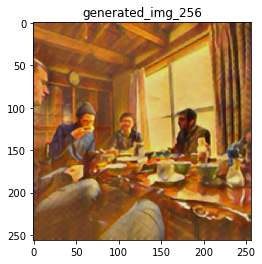

Fri Jan  8 03:05:44 2021 [50/500] time per pass: 146.95s  total time: 7347.73s  estimated time left: 18.41h  content: 3.731754  style: 1.465852  reg: 0.023635  total: 5.221241


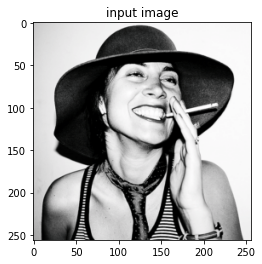

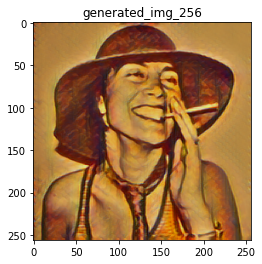

Fri Jan  8 03:11:13 2021 [75/500] time per pass: 102.36s  total time: 7677.23s  estimated time left: 12.11h  content: 3.556121  style: 1.490482  reg: 0.023221  total: 5.069825


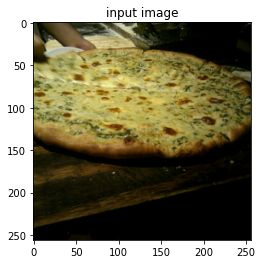

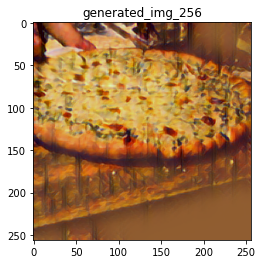

Fri Jan  8 03:16:39 2021 [100/500] time per pass: 80.03s  total time: 8002.79s  estimated time left: 8.91h  content: 3.628315  style: 1.460830  reg: 0.023090  total: 5.112235


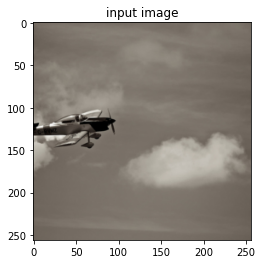

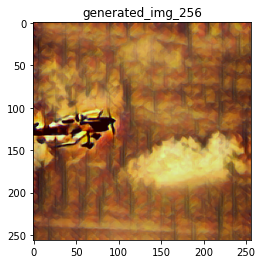

Fri Jan  8 03:22:06 2021 [125/500] time per pass: 66.64s  total time: 8329.89s  estimated time left: 6.96h  content: 3.658323  style: 1.443586  reg: 0.023518  total: 5.125427


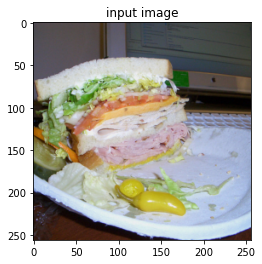

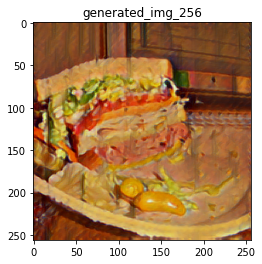

Fri Jan  8 03:27:30 2021 [150/500] time per pass: 57.70s  total time: 8654.55s  estimated time left: 5.63h  content: 3.597087  style: 1.575121  reg: 0.023481  total: 5.195689


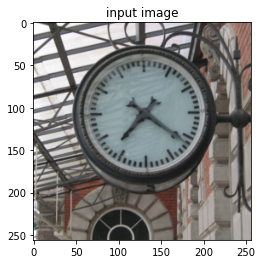

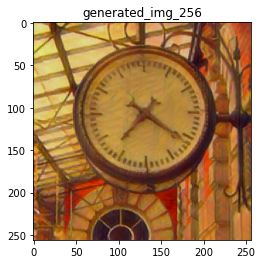

Fri Jan  8 03:32:56 2021 [175/500] time per pass: 51.31s  total time: 8979.64s  estimated time left: 4.65h  content: 3.671520  style: 1.492634  reg: 0.023544  total: 5.187698


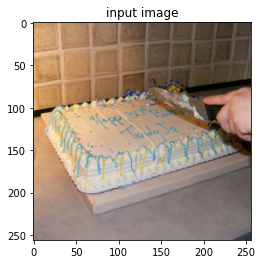

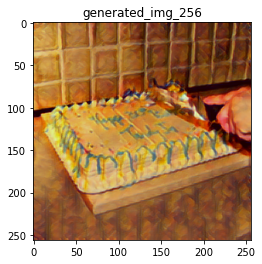

Fri Jan  8 03:38:20 2021 [200/500] time per pass: 46.52s  total time: 9304.19s  estimated time left: 3.89h  content: 3.579646  style: 1.436741  reg: 0.023877  total: 5.040265


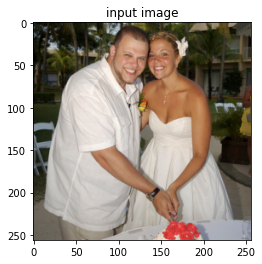

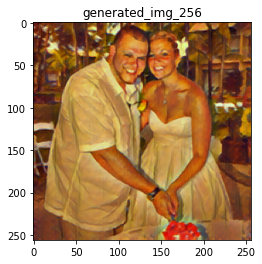

Fri Jan  8 03:43:57 2021 [225/500] time per pass: 42.85s  total time: 9641.14s  estimated time left: 3.29h  content: 3.473151  style: 1.434920  reg: 0.023510  total: 4.931581


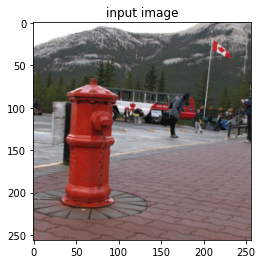

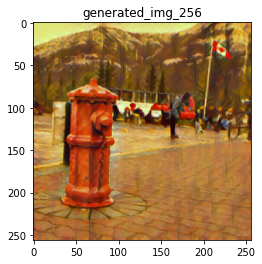

Fri Jan  8 03:49:24 2021 [250/500] time per pass: 39.87s  total time: 9967.84s  estimated time left: 2.78h  content: 3.388449  style: 1.433826  reg: 0.023645  total: 4.845921


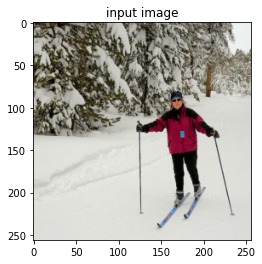

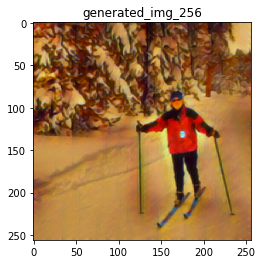

Fri Jan  8 03:54:49 2021 [275/500] time per pass: 37.43s  total time: 10293.21s  estimated time left: 2.35h  content: 3.422178  style: 1.444879  reg: 0.023997  total: 4.891054


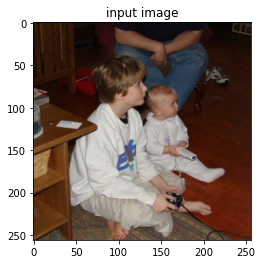

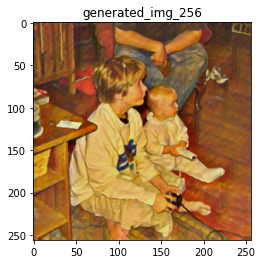

Fri Jan  8 04:00:13 2021 [300/500] time per pass: 35.39s  total time: 10617.19s  estimated time left: 1.98h  content: 3.452273  style: 1.490313  reg: 0.023593  total: 4.966179


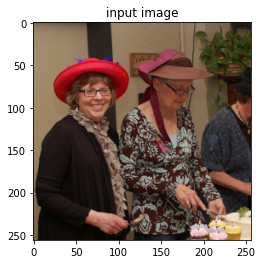

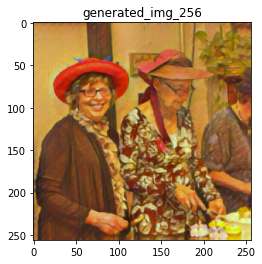

Fri Jan  8 04:05:39 2021 [325/500] time per pass: 33.67s  total time: 10942.96s  estimated time left: 1.65h  content: 3.460906  style: 1.417895  reg: 0.024275  total: 4.903075


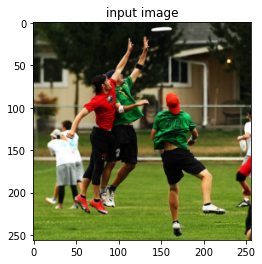

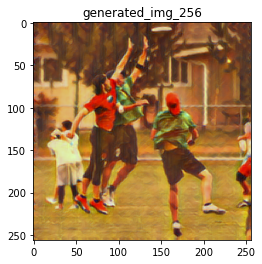

Fri Jan  8 04:11:06 2021 [350/500] time per pass: 32.20s  total time: 11270.21s  estimated time left: 1.35h  content: 3.440014  style: 1.493038  reg: 0.023334  total: 4.956386


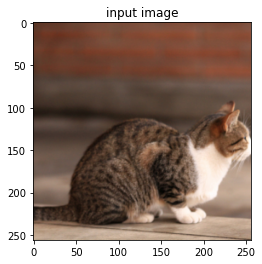

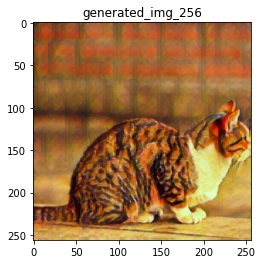

Fri Jan  8 04:16:34 2021 [375/500] time per pass: 30.93s  total time: 11598.42s  estimated time left: 1.08h  content: 3.325223  style: 1.447440  reg: 0.023499  total: 4.796162


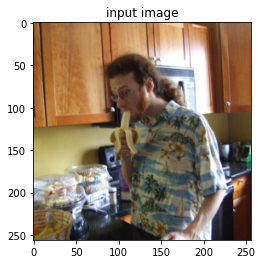

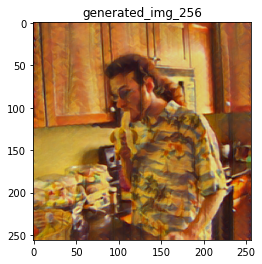

Fri Jan  8 04:22:00 2021 [400/500] time per pass: 29.81s  total time: 11924.12s  estimated time left: 0.84h  content: 3.276858  style: 1.373138  reg: 0.024089  total: 4.674085


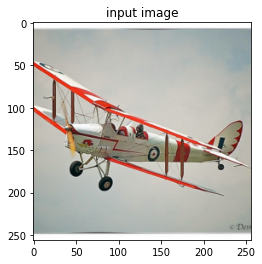

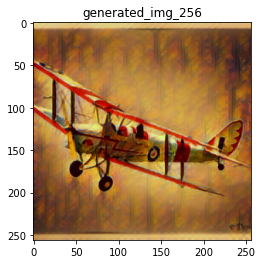

Fri Jan  8 04:27:27 2021 [425/500] time per pass: 28.83s  total time: 12251.12s  estimated time left: 0.61h  content: 3.330782  style: 1.398753  reg: 0.023710  total: 4.753246


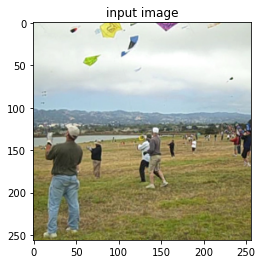

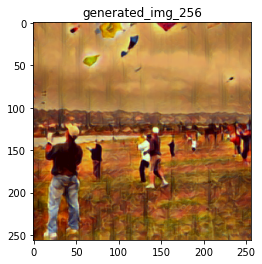

Fri Jan  8 04:32:56 2021 [450/500] time per pass: 27.96s  total time: 12580.06s  estimated time left: 0.40h  content: 3.316895  style: 1.414551  reg: 0.023615  total: 4.755062


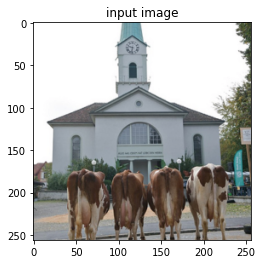

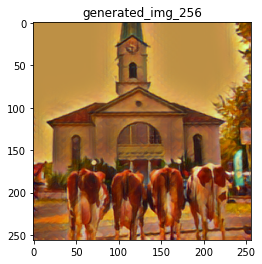

Fri Jan  8 04:38:21 2021 [475/500] time per pass: 27.17s  total time: 12905.29s  estimated time left: 0.20h  content: 3.254215  style: 1.437952  reg: 0.023567  total: 4.715734


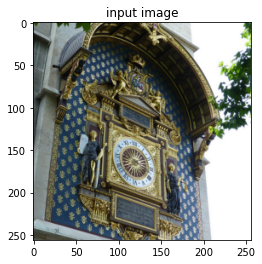

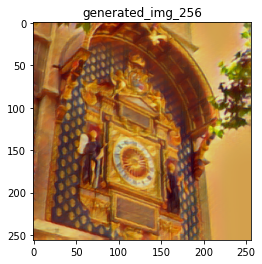

Fri Jan  8 04:43:49 2021 [500/500] time per pass: 26.47s  total time: 13232.64s  estimated time left: 0.01h  content: 3.290616  style: 1.447280  reg: 0.023921  total: 4.761817


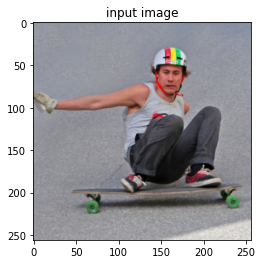

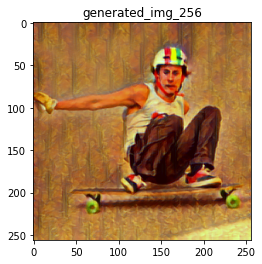

In [182]:
""" Perform Training """

style_subnet.train()
start = time.time()
print("Start training on {}...".format(device))
for epoch in range(NUM_EPOCHS):
    agg_content_loss, agg_style_loss, agg_reg_loss = 0., 0., 0.
    log_counter = 0
    for i, (x, _) in enumerate(train_loader):
        
        
        # update learning rate every 2000 iterations
        if i % 2000 == 0 and i != 0:
            LR = LR * 0.8
            optimizer = torch.optim.Adam(list(style_subnet.parameters()), lr=LR)


        optimizer.zero_grad()
        x_in = x.clone()
        
        """ Style Subnet """
        x_in = Variable(x_in).to(device)

        # Generate image
        generated_img_256, resized_input_img_256 = style_subnet(x_in)
        resized_input_img_256 = Variable(resized_input_img_256.data)
        
        # Compute Losses
        style_subnet_content_loss, style_subnet_style_loss, style_subnet_reg_loss = getLosses(
            generated_img_256,
            resized_input_img_256,
            CONTENT_WEIGHTS[0],
            STYLE_WEIGHTS[0],
            mse_loss, gram_style_256)
        

        # Total loss
        total_loss = LAMBDAS[0] * (style_subnet_content_loss + style_subnet_style_loss + style_subnet_reg_loss)
        total_loss.backward()
        optimizer.step()

        # Aggregated loss
        agg_content_loss += style_subnet_content_loss.data
        agg_style_loss += style_subnet_style_loss.data
        agg_reg_loss += style_subnet_reg_loss.data
        
        
        # log training process
        if (i + 1) % LOG_INTERVAL == 0:
            log_counter += 1
            hlp = log_counter * LOG_INTERVAL
            time_per_pass = (time.time() - start) / hlp
            estimated_time_left = (time_per_pass * (max_iterations - i))/3600
            print("{} [{}/{}] time per pass: {:.2f}s  total time: {:.2f}s  estimated time left: {:.2f}h  content: {:.6f}  style: {:.6f}  reg: {:.6f}  total: {:.6f}".format(
                        time.ctime(), i+1, max_iterations,
                        (time.time() - start) / hlp,
                        time.time() - start,
                        estimated_time_left,
                        agg_content_loss / LOG_INTERVAL,
                        agg_style_loss / LOG_INTERVAL,
                        agg_reg_loss / LOG_INTERVAL,
                        (agg_content_loss + agg_style_loss + agg_reg_loss) / LOG_INTERVAL))
            agg_content_loss, agg_style_loss, agg_reg_loss = 0., 0., 0.
            imshow(x[0], title="input image")
            imshow(generated_img_256[0], title="generated_img_256")

        """
        if (i + 1) % (10 * LOG_INTERVAL) == 0:
            save_image(generated_img_256, title="log_data/256_iteration_{}_of_{}".format(i+1, max_iterations))
            save_image(generated_img_512, title="log_data/512_iteration_{}_of_{}".format(i+1, max_iterations))
            save_image(generated_img_1024, title="log_data/1024_iteration_{}_of_{}".format(i+1, max_iterations))
            torch.save(style_subnet, 'log_data/trained_style_subnet_it_{}_of_{}.pt'.format(i+1, max_iterations))
            torch.save(enhance_subnet, 'log_data/trained_enhance_subnet_it_{}_of_{}.pt'.format(i+1, max_iterations))
            torch.save(refine_subnet, 'log_data/trained_refine_subnet_it_{}_of_{}.pt'.format(i+1, max_iterations))
            print("Images and models saved in /log_one_data")
        """

        # Stop training after max iterations
        if (i + 1) == max_iterations: break

""" Save model """
torch.save(style_subnet, 'models/style_subnet_trained1.pt')